# Google Mobility Reportによる各国・地域での人の移動量の可視化ノートブック
COVID19後に、人の移動量がどの程度変動したのかを、Googleが公開している[Google Mobility Report](https://www.google.com/covid19/mobility/)のデータを利用して可視化する。
いずれも、2020年1月での移動量を基準値として、その基準値と比較した割合として移動量を表示する。

## 関連パッケージのインストール
初回のみ実行が必要。
実行後にコメントアウトすると良い。

In [1]:
!conda install -y --freeze-installed pandas matplotlib scipy

Solving environment: done

## Package Plan ##

  environment location: /home/seagetch/anaconda3/envs/covid19

  added / updated specs:
    - matplotlib
    - pandas
    - scipy


The following packages will be UPDATED:

  ca-certificates    conda-forge::ca-certificates-2020.12.~ --> pkgs/main::ca-certificates-2021.4.13-h06a4308_1

The following packages will be SUPERSEDED by a higher-priority channel:

  certifi            conda-forge::certifi-2020.12.5-py39hf~ --> pkgs/main::certifi-2020.12.5-py39h06a4308_0
  openssl            conda-forge::openssl-1.1.1k-h7f98852_0 --> pkgs/main::openssl-1.1.1k-h27cfd23_0


Preparing transaction: done
Verifying transaction: done
Executing transaction: done


## 初期化

In [2]:
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import datetime
from pprint import pprint
%matplotlib inline
font = {'family' : 'Noto Sans CJK JP'}
matplotlib.rc('font', **font)

In [3]:
%%html

<style>
    .jp-OutputArea-child {
        display: inline-block;
    }
</style>

## データ取得
GoogleのGlobal Mobility Reportファイルをダウンロードしてカレントディレクトリに置き、それをdfとして読み込む。

In [4]:
!wget https://www.gstatic.com/covid19/mobility/Global_Mobility_Report.csv -O data/Global_Mobility_Report.csv
df = pd.read_csv("data/Global_Mobility_Report.csv")
df

--2021-05-26 11:36:17--  https://www.gstatic.com/covid19/mobility/Global_Mobility_Report.csv
www.gstatic.com (www.gstatic.com) をDNSに問いあわせています... 2404:6800:4004:81b::2003, 172.217.25.227
www.gstatic.com (www.gstatic.com)|2404:6800:4004:81b::2003|:443 に接続しています... 接続しました。
HTTP による接続要求を送信しました、応答を待っています... 200 OK
長さ: 537810976 (513M) [text/csv]
`data/Global_Mobility_Report.csv' に保存中

data/Global_Mobilit 100%[===================>] 512.90M  10.4MB/s    in 48s     

2021-05-26 11:37:06 (10.6 MB/s) - `data/Global_Mobility_Report.csv' へ保存完了 [537810976/537810976]



/home/seagetch/anaconda3/envs/covid19/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3165: DtypeWarning: Columns (4,5) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


,country_region_code,country_region,sub_region_1,sub_region_2,metro_area,iso_3166_2_code,census_fips_code,place_id,date,retail_and_recreation_percent_change_from_baseline,grocery_and_pharmacy_percent_change_from_baseline,parks_percent_change_from_baseline,transit_stations_percent_change_from_baseline,workplaces_percent_change_from_baseline,residential_percent_change_from_baseline
0,AE,United Arab Emirates,NaN,NaN,NaN,NaN,NaN,ChIJvRKrsd9IXj4RpwoIwFYv0zM,2020-02-15,0.0,4.0,5.0,0.0,2.0,1.0
1,AE,United Arab Emirates,NaN,NaN,NaN,NaN,NaN,ChIJvRKrsd9IXj4RpwoIwFYv0zM,2020-02-16,1.0,4.0,4.0,1.0,2.0,1.0
2,AE,United Arab Emirates,NaN,NaN,NaN,NaN,NaN,ChIJvRKrsd9IXj4RpwoIwFYv0zM,2020-02-17,-1.0,1.0,5.0,1.0,2.0,1.0
3,AE,United Arab Emirates,NaN,NaN,NaN,NaN,NaN,ChIJvRKrsd9IXj4RpwoIwFYv0zM,2020-02-18,-2.0,1.0,5.0,0.0,2.0,1.0
4,AE,United Arab Emirates,NaN,NaN,NaN,NaN,NaN,ChIJvRKrsd9IXj4RpwoIwFYv0zM,2020-02-19,-2.0,0.0,4.0,-1.0,2.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5485794,ZW,Zimbabwe,Midlands Province,Kwekwe,NaN,NaN,NaN,ChIJRcIZ3-FJNBkRRsj55IcLpfU,2021-05-17,NaN,NaN,NaN,NaN,26.0,NaN
5485795,ZW,Zimbabwe,Midlands Province,Kwekwe,NaN,NaN,NaN,ChIJRcIZ3-FJNBkRRsj55IcLpfU,2021-05-18,NaN,NaN,NaN,NaN,35.0,NaN
5485796,ZW,Zimbabwe,Midlands Province,Kwekwe,NaN,NaN,NaN,ChIJRcIZ3-FJNBkRRsj55IcLpfU,2021-05-19,NaN,NaN,NaN,NaN,24.0,NaN
5485797,ZW,Zimbabwe,Midlands Province,Kwekwe,NaN,NaN,NaN,ChIJRcIZ3-FJNBkRRsj55IcLpfU,2021-05-20,NaN,NaN,NaN,NaN,21.0,NaN


## 国名の確認
レポートに含まれる国の一覧を確認する。

In [5]:
group = df.groupby("country_region")
countries = [x for x,y in group]
pprint(countries, compact=True)

['Afghanistan', 'Angola', 'Antigua and Barbuda', 'Argentina', 'Aruba',
 'Australia', 'Austria', 'Bahrain', 'Bangladesh', 'Barbados', 'Belarus',
 'Belgium', 'Belize', 'Benin', 'Bolivia', 'Bosnia and Herzegovina', 'Botswana',
 'Brazil', 'Bulgaria', 'Burkina Faso', 'Cambodia', 'Cameroon', 'Canada',
 'Cape Verde', 'Chile', 'Colombia', 'Costa Rica', 'Croatia', 'Czechia',
 "Côte d'Ivoire", 'Denmark', 'Dominican Republic', 'Ecuador', 'Egypt',
 'El Salvador', 'Estonia', 'Fiji', 'Finland', 'France', 'Gabon', 'Georgia',
 'Germany', 'Ghana', 'Greece', 'Guatemala', 'Guinea-Bissau', 'Haiti',
 'Honduras', 'Hong Kong', 'Hungary', 'India', 'Indonesia', 'Iraq', 'Ireland',
 'Israel', 'Italy', 'Jamaica', 'Japan', 'Jordan', 'Kazakhstan', 'Kenya',
 'Kuwait', 'Kyrgyzstan', 'Laos', 'Latvia', 'Lebanon', 'Libya', 'Liechtenstein',
 'Lithuania', 'Luxembourg', 'Malaysia', 'Mali', 'Malta', 'Mauritius', 'Mexico',
 'Moldova', 'Mongolia', 'Morocco', 'Mozambique', 'Myanmar (Burma)', 'Namibia',
 'Nepal', 'Netherlands',

In [6]:
df.columns

Index(['country_region_code', 'country_region', 'sub_region_1', 'sub_region_2',
       'metro_area', 'iso_3166_2_code', 'census_fips_code', 'place_id', 'date',
       'retail_and_recreation_percent_change_from_baseline',
       'grocery_and_pharmacy_percent_change_from_baseline',
       'parks_percent_change_from_baseline',
       'transit_stations_percent_change_from_baseline',
       'workplaces_percent_change_from_baseline',
       'residential_percent_change_from_baseline'],
      dtype='object')

## 移動量の特徴可視化

### 初期設定

#### 列名とその表示名の設定
レポート中で分析対象とするデータ列名(situation)と、その表示名(sit_legends)を設定する。


In [7]:
situations=[
    "retail_and_recreation_percent_change_from_baseline",
    "grocery_and_pharmacy_percent_change_from_baseline",
    "parks_percent_change_from_baseline",
    "transit_stations_percent_change_from_baseline",
    "workplaces_percent_change_from_baseline",
    "residential_percent_change_from_baseline"
]
sit_legends=[
    "小売&娯楽",
    "食料品店&薬局",
    "公園",
    "乗換駅",
    "職場",
    "住宅地"
]

### 移動量概要のレポート
いくつかの国の月ごとの移動量の変化をサマリとして表示する

<ipython-input-8-88dbb9cadeba>:9: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  df3 = df.groupby([df["date"].dt.year, df["date"].dt.month, df["country_region"]]).apply(lambda df: df.mean())


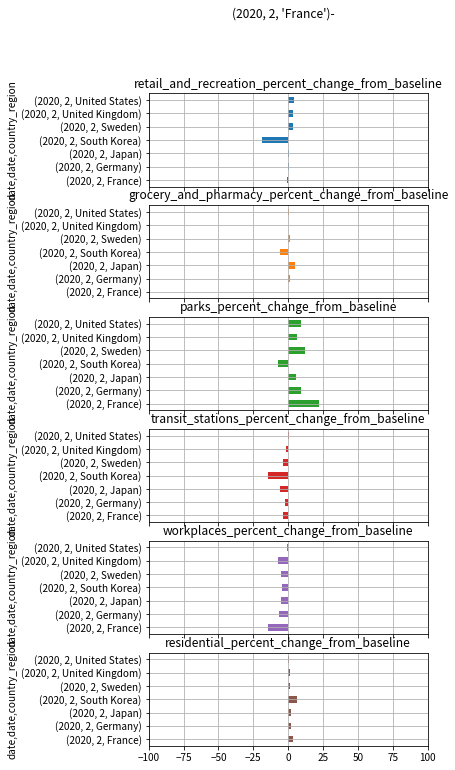

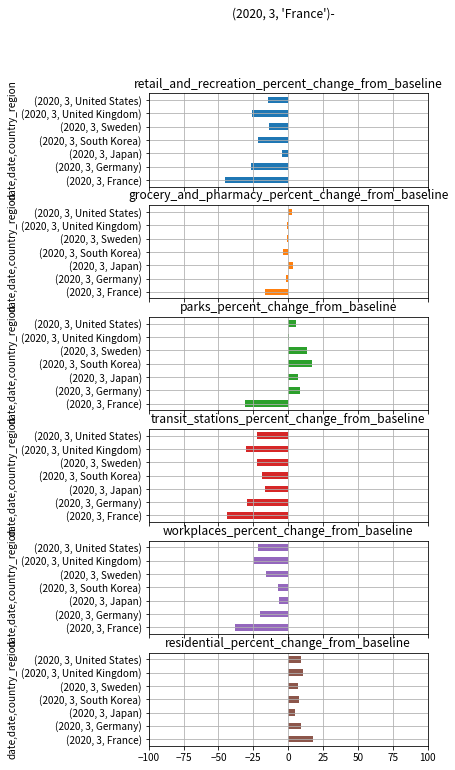

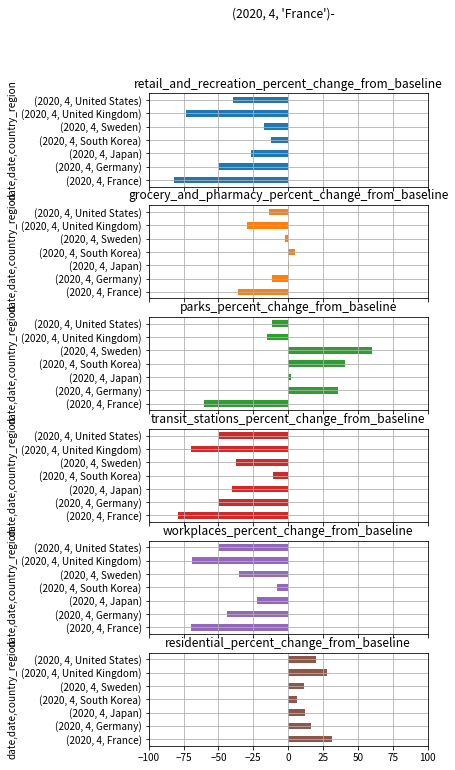

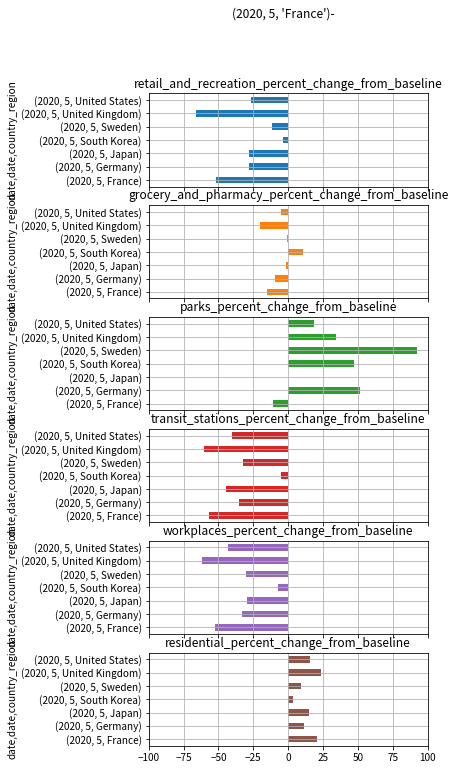

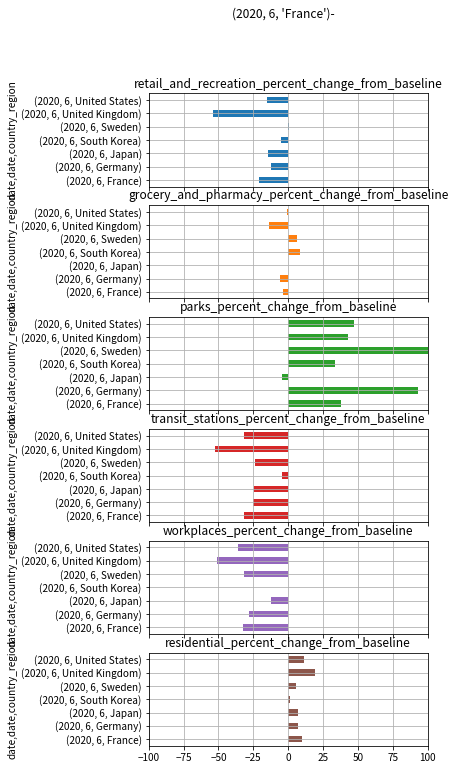

...

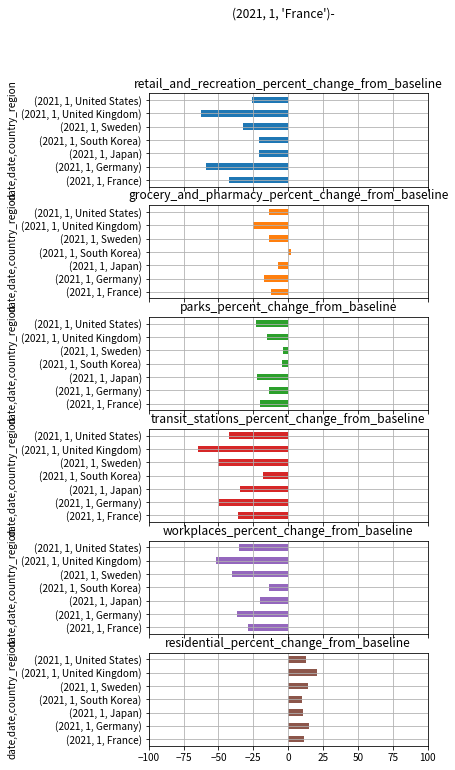

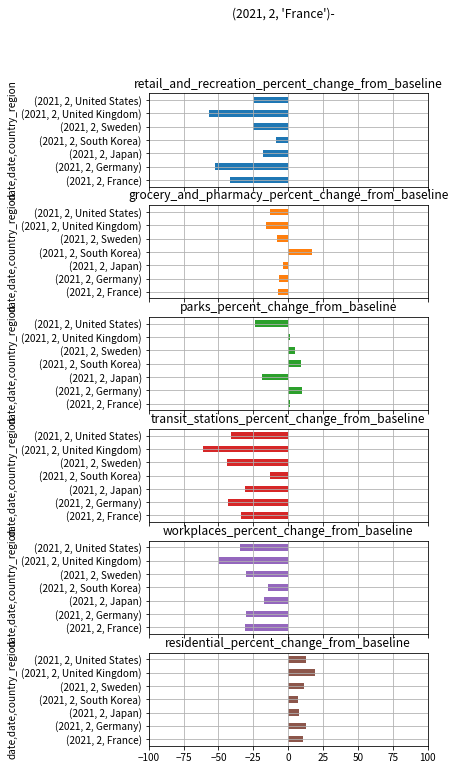

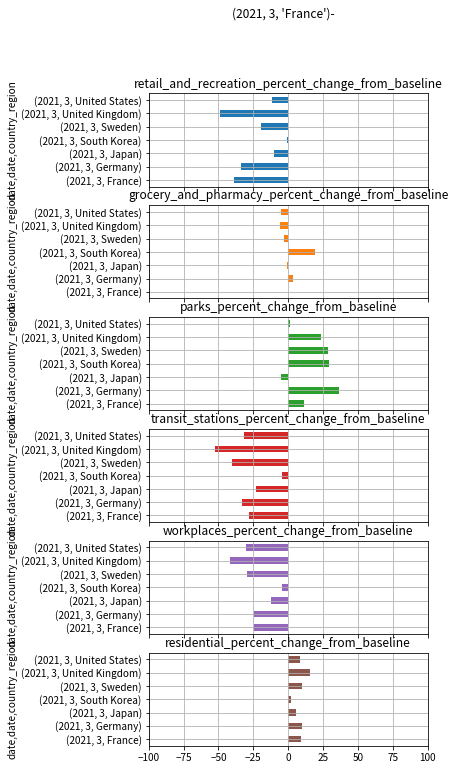

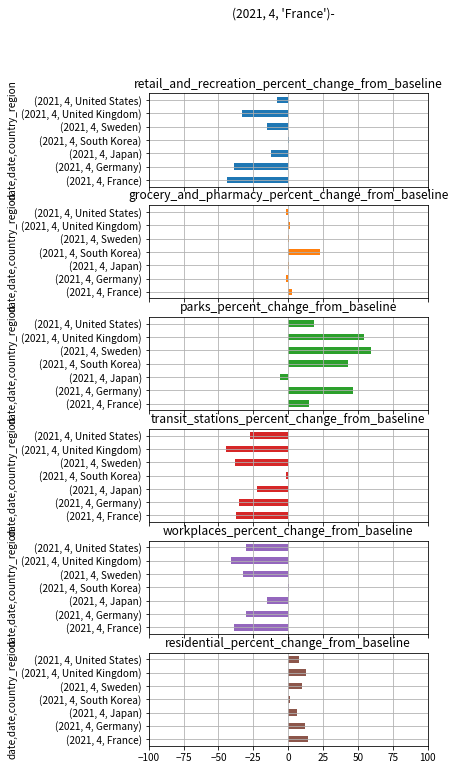

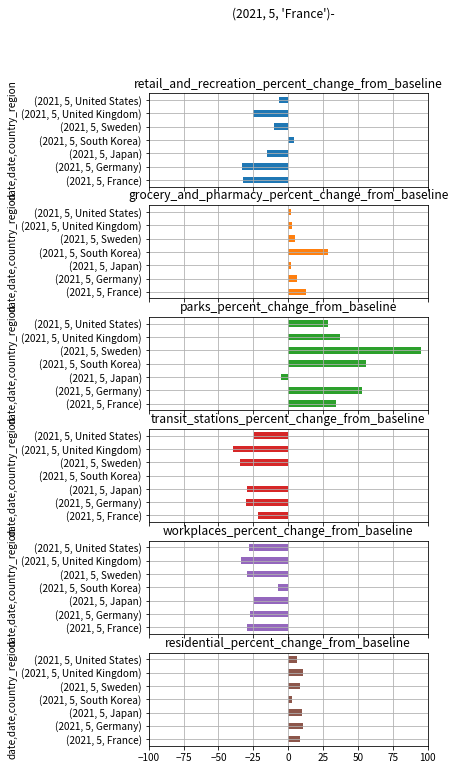

In [8]:
countries = ["Japan", "South Korea", "Germany", "France", "United Kingdom", "Sweden", "United States"]
df["date"] = pd.to_datetime(df["date"])
df2 = df.loc[df["country_region"].isin(countries)].loc[df["sub_region_1"].isnull()].loc[df["metro_area"].isnull()]

# 平日のみを対象とする
df2 = df2.loc[df["date"].dt.weekday < 5]

def analysis_on_country(df):
    df3 = df.groupby([df["date"].dt.year, df["date"].dt.month, df["country_region"]]).apply(lambda df: df.mean())
    for c,df4 in df3.groupby(level=[0, 1]):
        df4[situations].plot(kind="barh", title="%s-%s"%(df4.index[0], ""), figsize=(5, 12), subplots=True, sharex=True, legend=False, xlim=[-100, 100], grid=True)
    return None

#df2.set_index("country_region").groupby("country_region").apply(analysis_on_country)
analysis_on_country(df2)

### 各国の可視化

#### 分析する地域、国名の設定
各地域ごとに調査する国名を設定する



In [9]:
FEAsiaSample=["Japan", "South Korea", "Taiwan", "Philippines", "Singapore", "Indonesia","Malaysia","Australia"]
EuropeSample=["Germany", "France", "Italy", "United Kingdom", "Spain", "Netherlands", "Sweden", "Norway", "Russia"]
AmericaSample=["United States", "Canada", "Brazil", "Argentina", "Chile","Colombia","Peru","Bolivia"]
AfricaSample=["Egypt", "Nigeria", "South Africa", "Kenya"]
AsiaSample=["India", "Iraq", "Israel", "Ukraine", "Saudi Arabia", "Pakistan", "Kazakhstan", "Turkey", "Bangladesh" ]

Areas={
    "Far East & Oceania": FEAsiaSample, 
    "Europe": EuropeSample,
    "America": AmericaSample,
    "Africa": AfricaSample,
    "Asia": AsiaSample,
      }


#### 国別の移動量の時系列表示

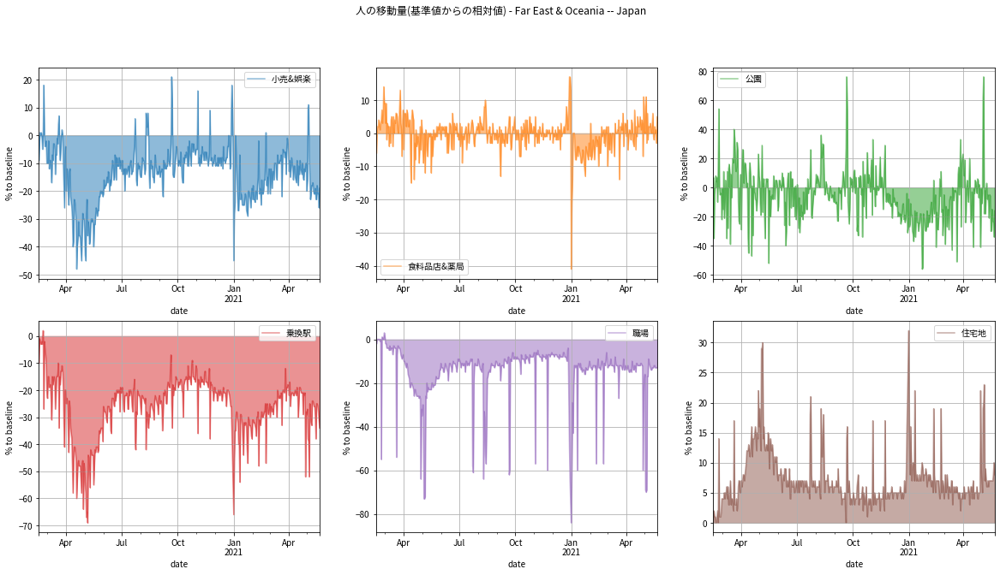

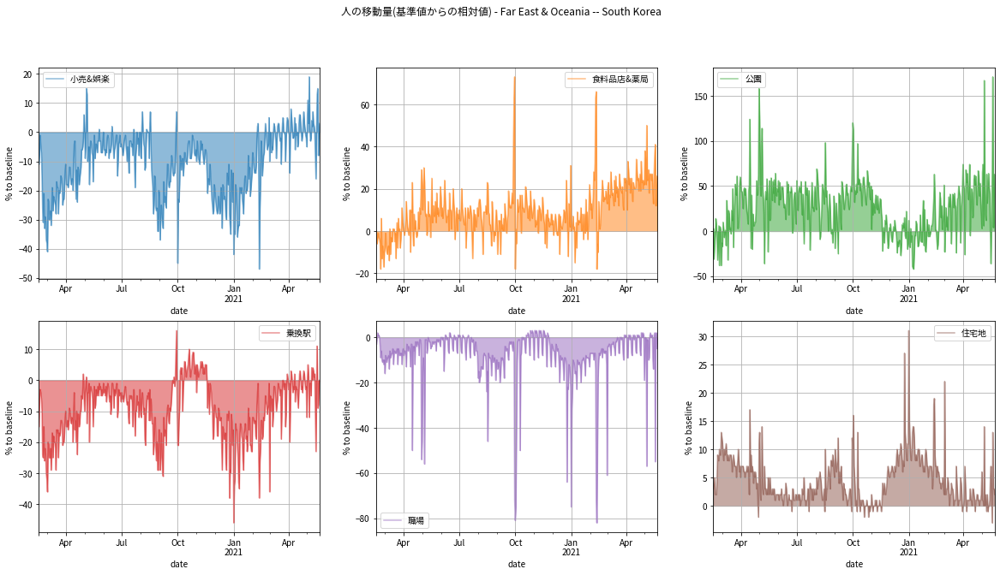

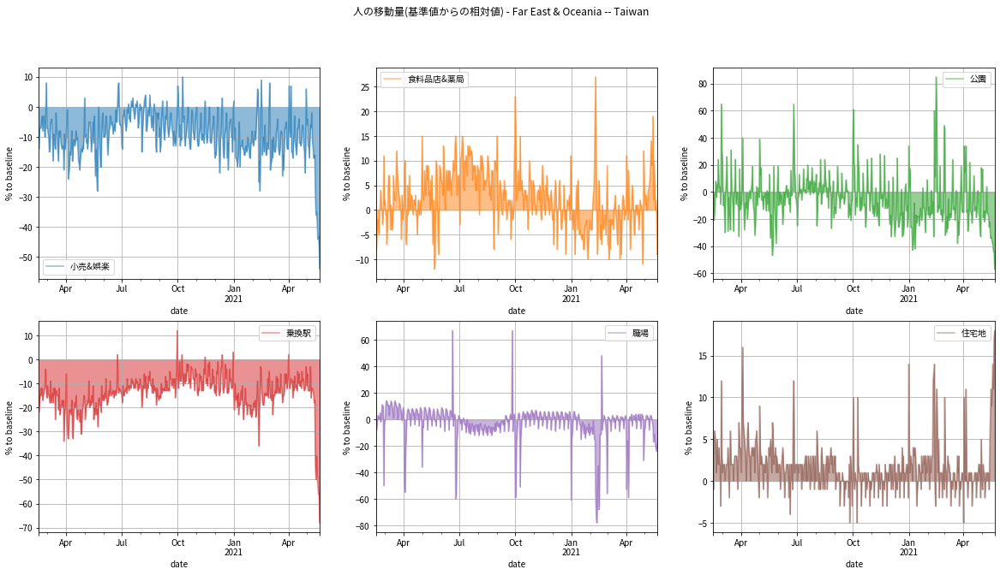

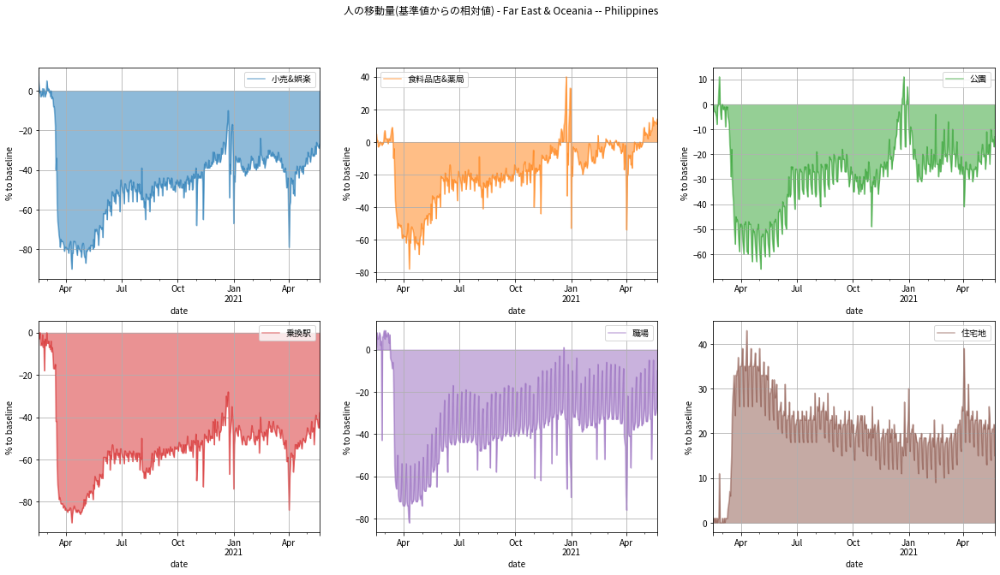

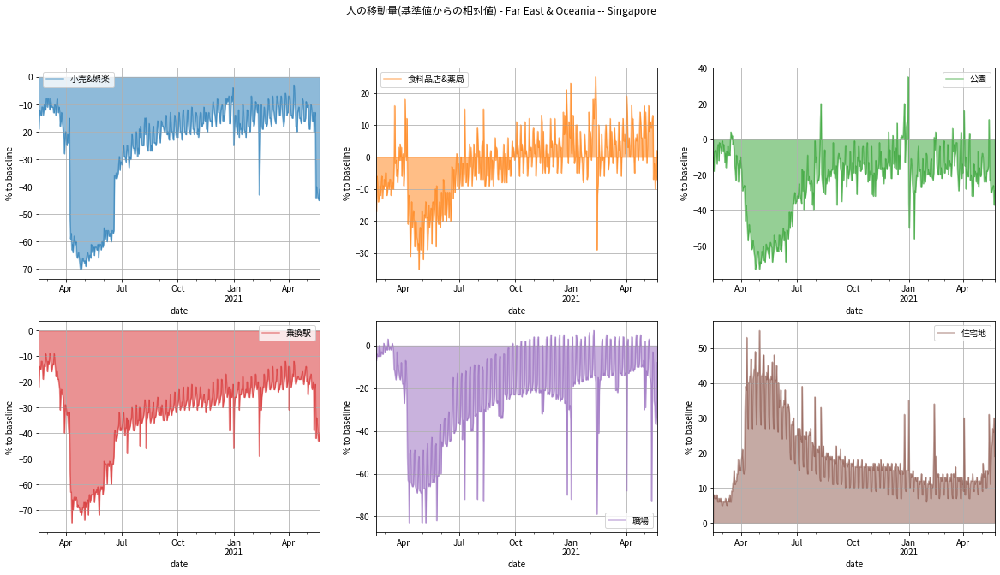

...

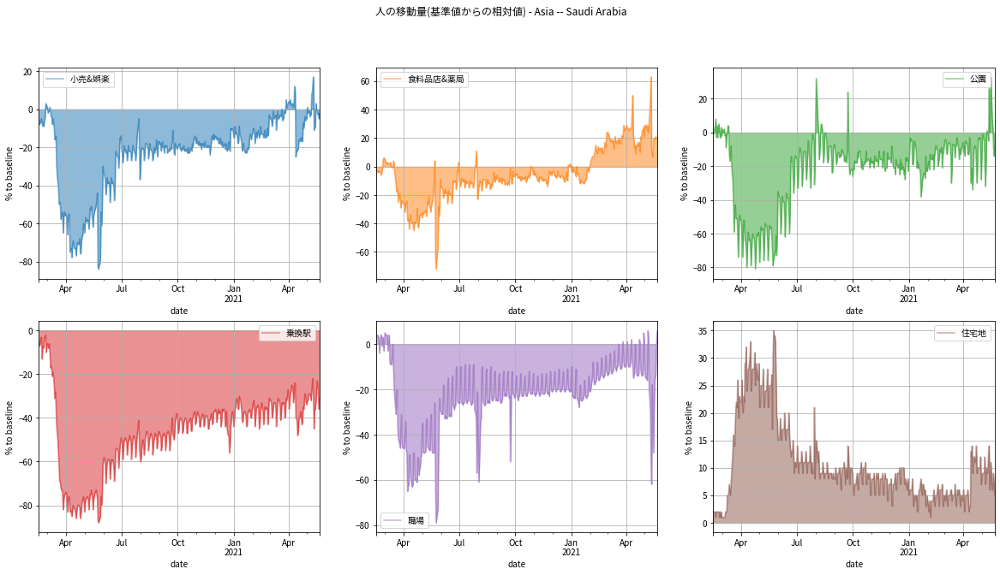

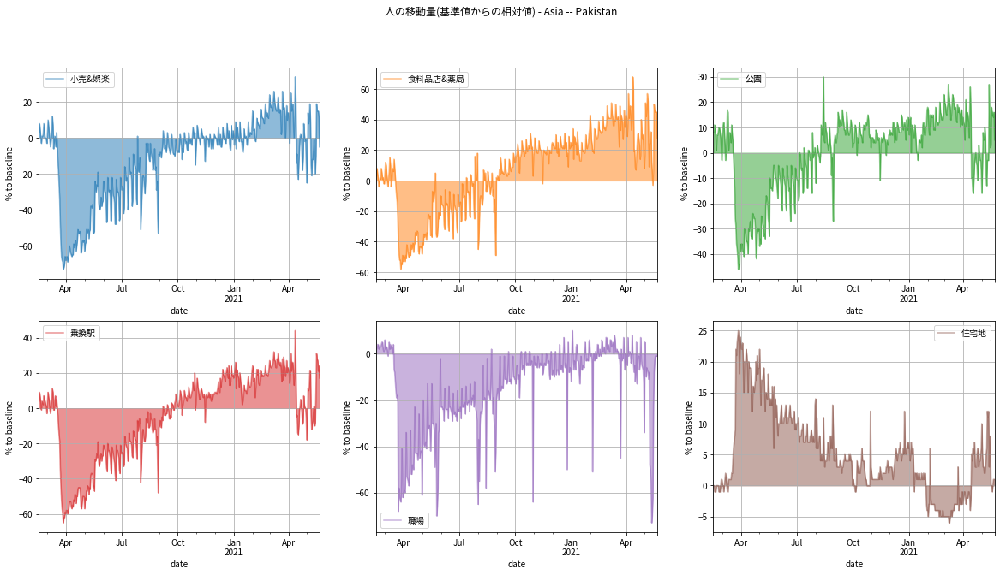

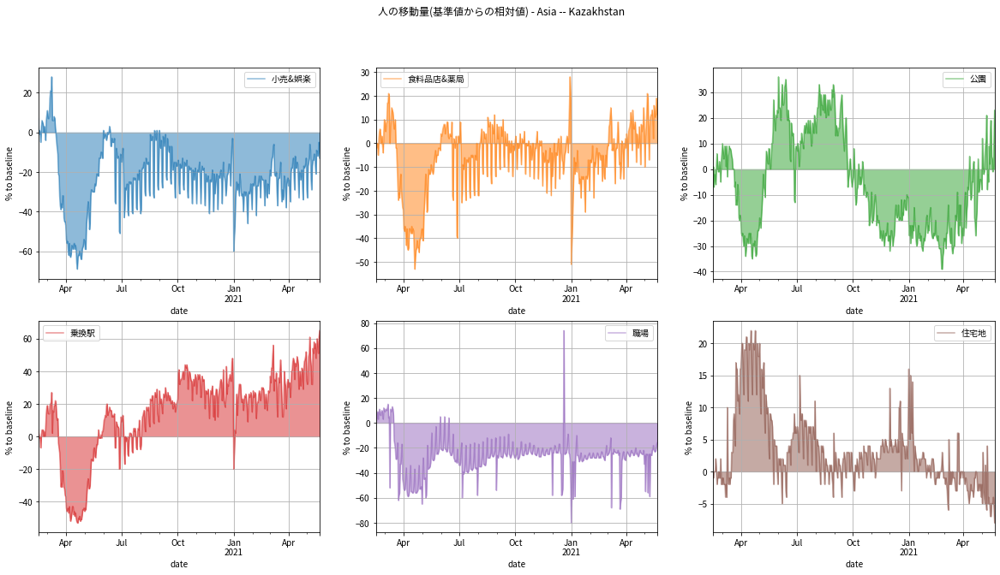

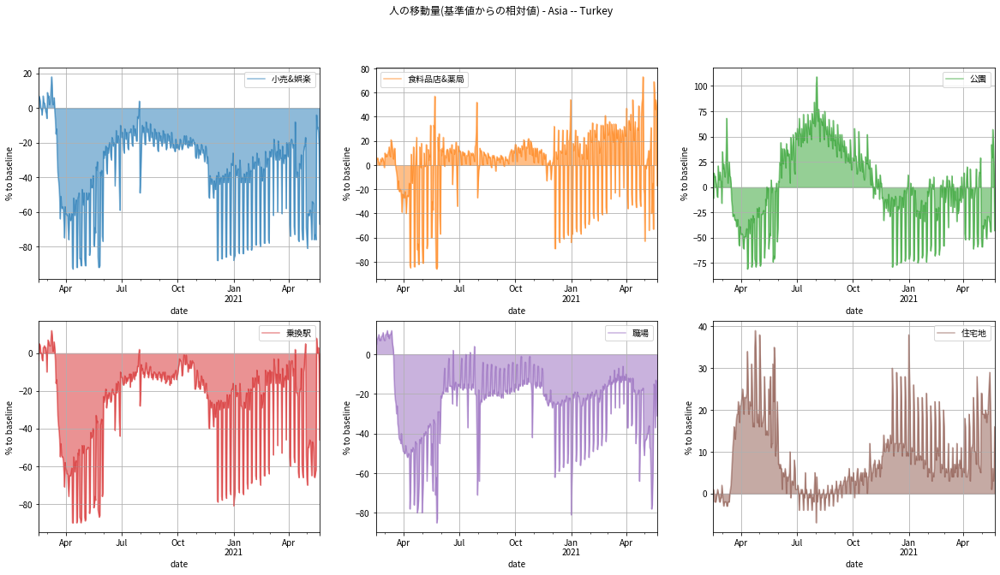

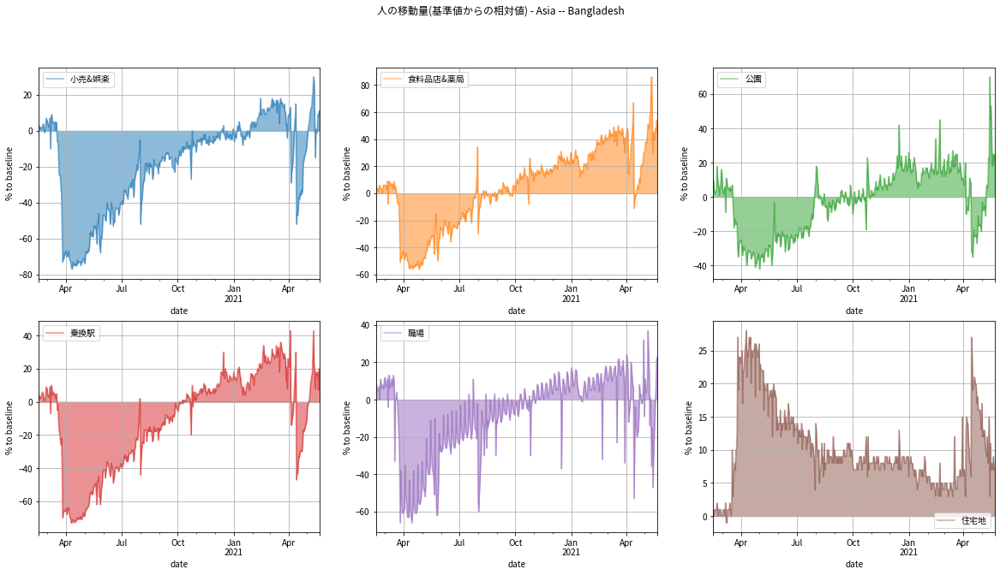

In [10]:
!mkdir -p mobility
for area, samples in Areas.items():
    for c in samples:
        subdf = df.loc[df["country_region"] == c].loc[df["sub_region_1"].isnull()].loc[df["sub_region_2"].isnull()].loc[df["metro_area"].isnull()].sort_values("date")
        axes = subdf.plot(kind="area", stacked=False, x="date", y=situations, 
                          title="人の移動量(基準値からの相対値) - %s -- %s"%(area,c), 
                          subplots=True, sharex=False, 
                          layout=(2,3), figsize=(20,10), grid=True)
        for a, l in zip(axes.flatten().tolist(), sit_legends):
            a.legend([l,])
            a.xaxis_date()
            a.set_ylabel("% to baseline")
        plt.savefig("mobility/%s-%s.png"%(area, c), facecolor="white")
        plt.show()
        plt.close()

### 日本の県別表示
日本の移動量を県別に表示する

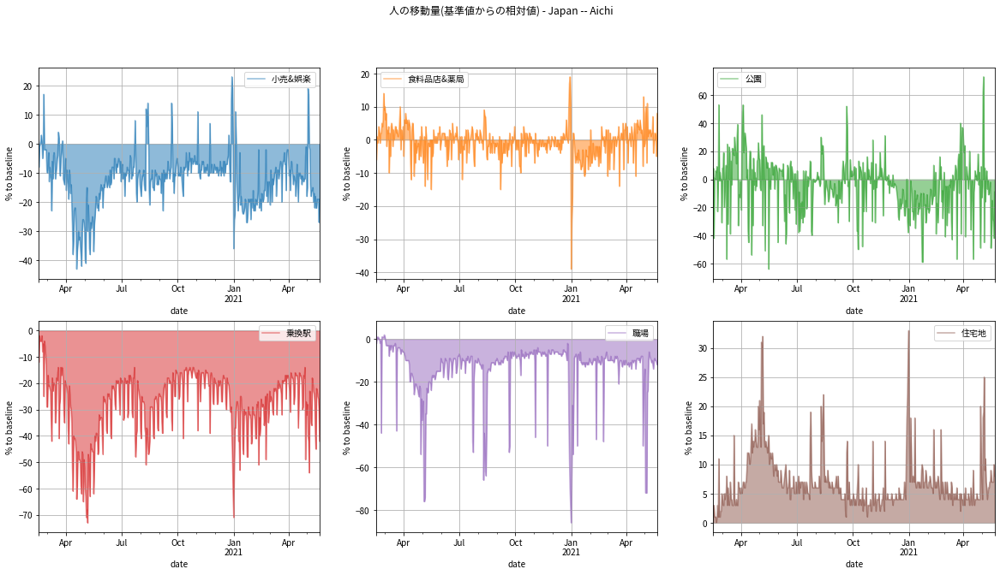

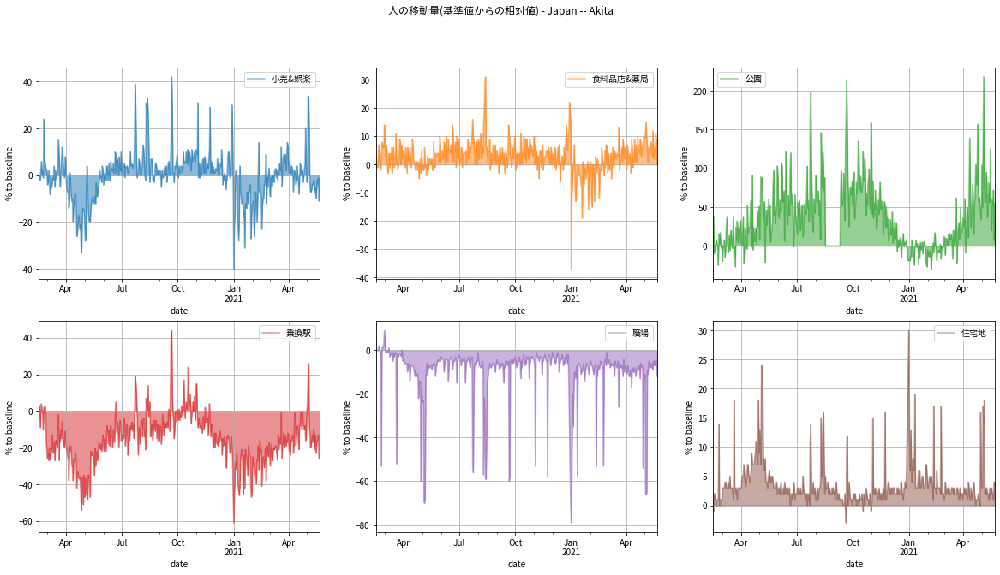

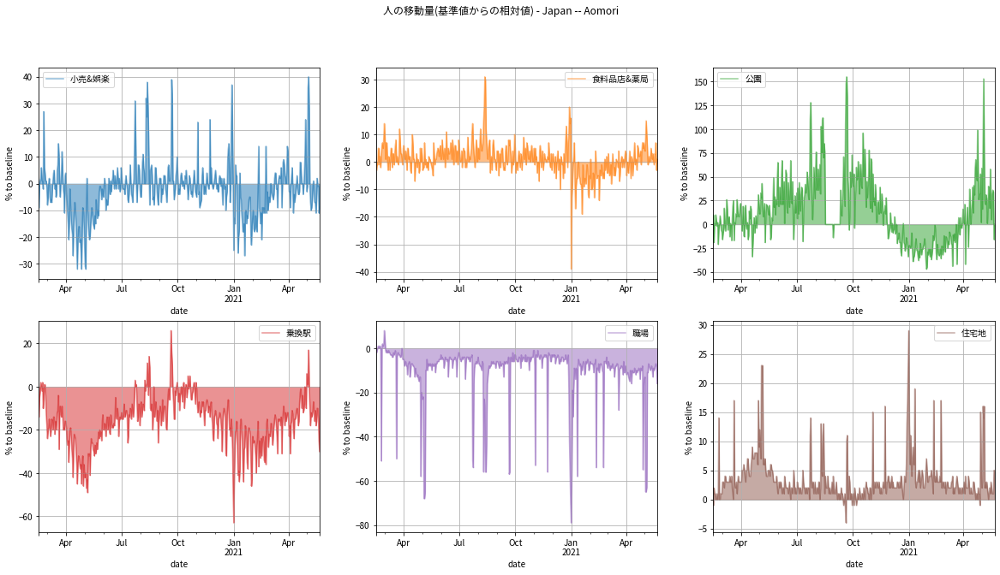

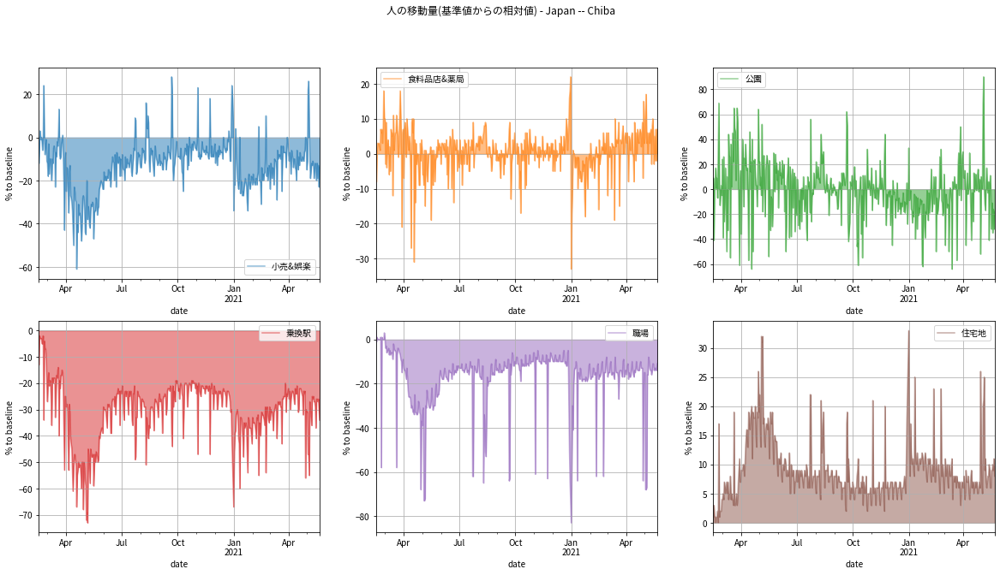

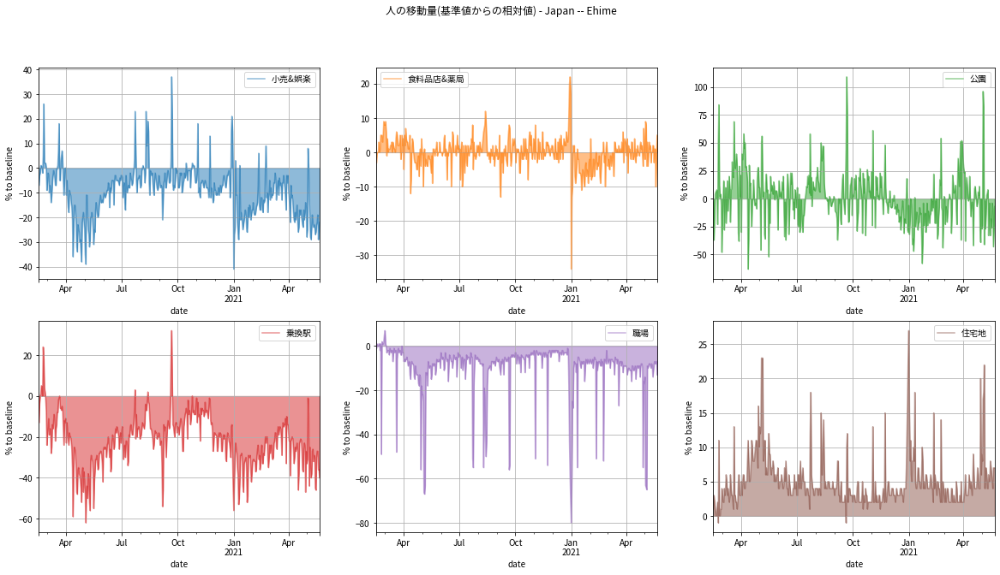

...

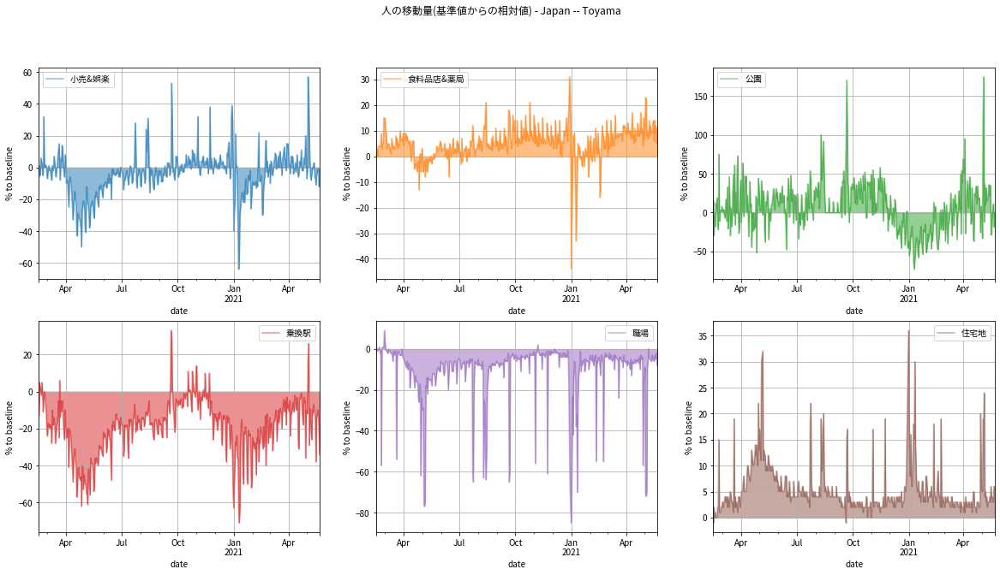

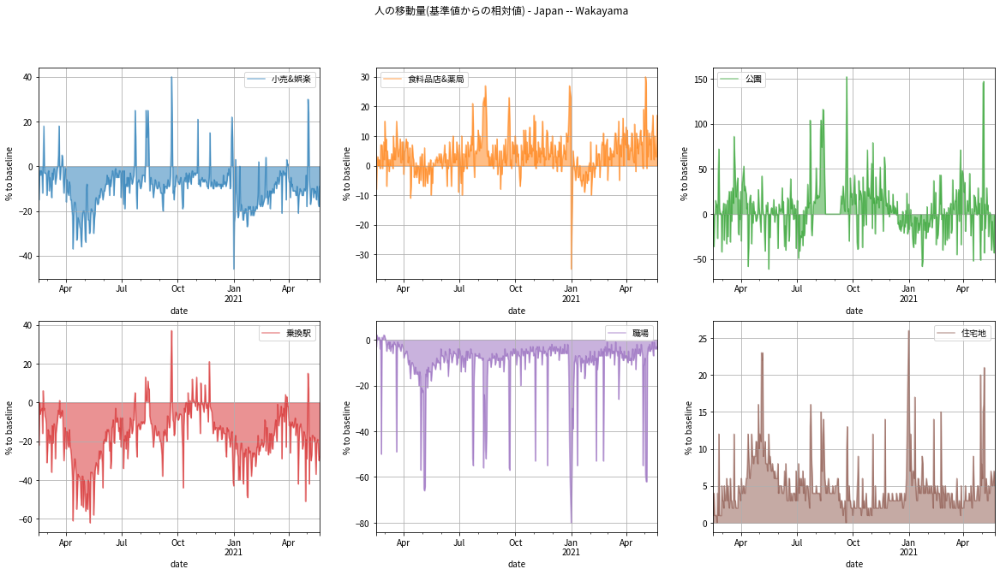

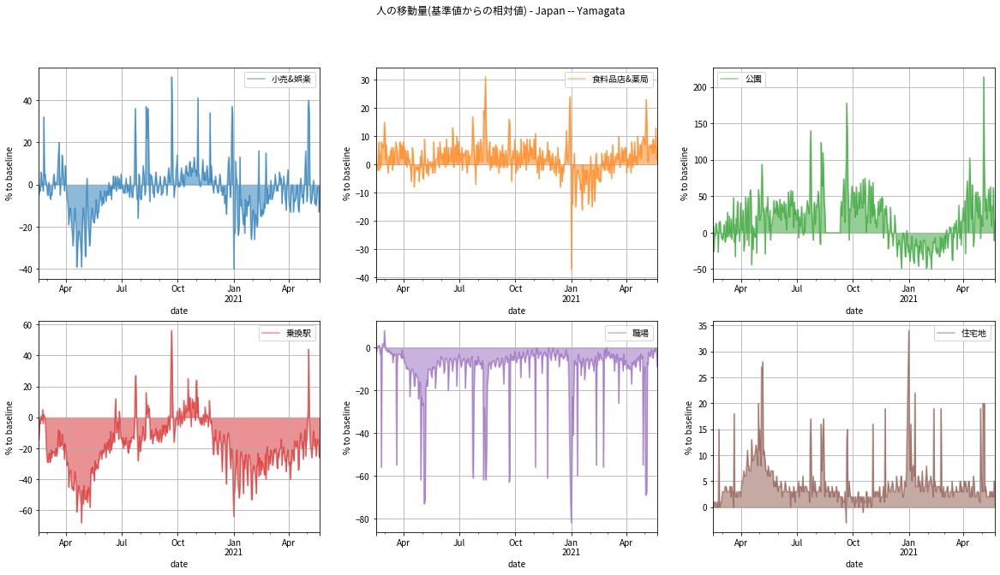

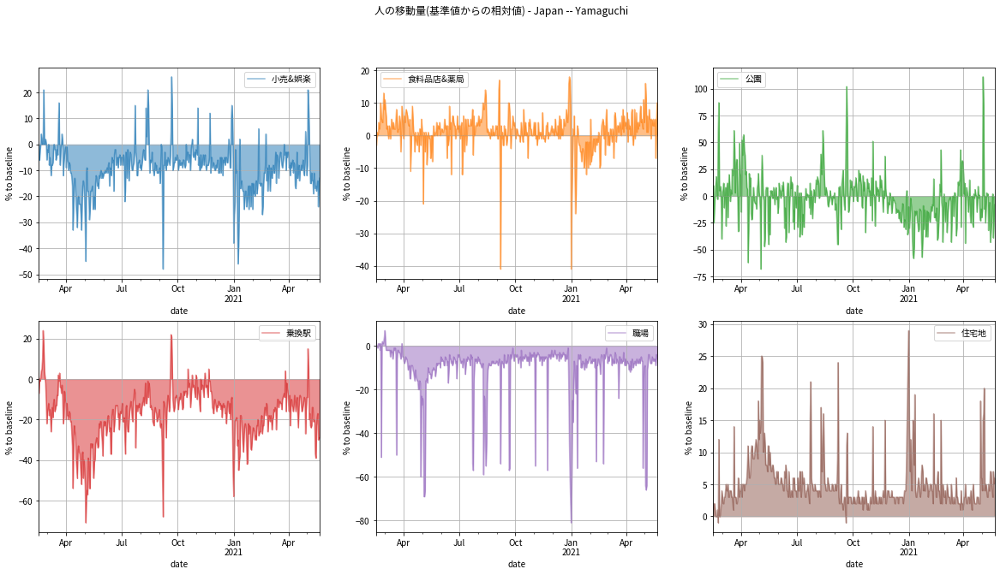

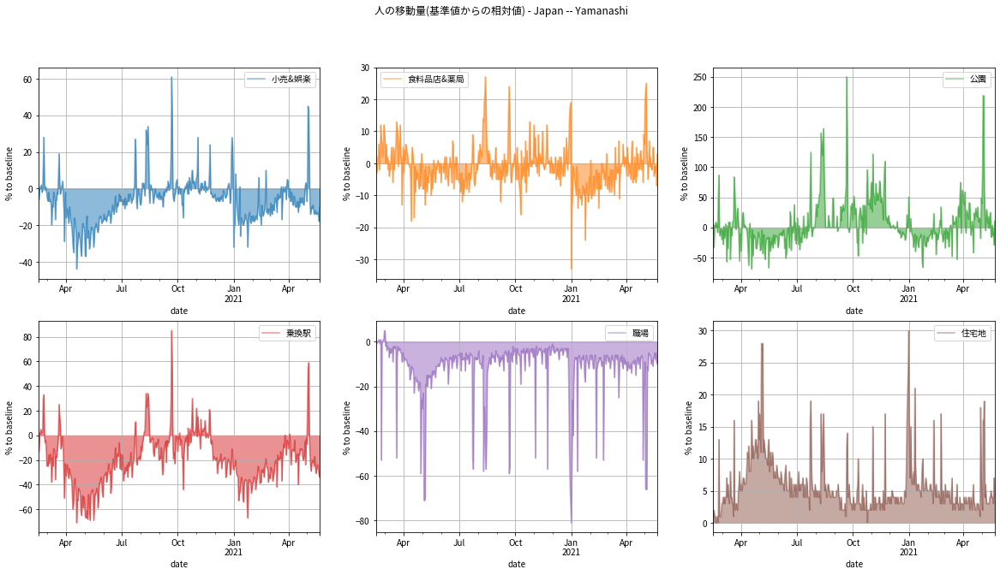

In [11]:
!mkdir -p mobility/japan

c="Japan"
subdf = df.loc[df["country_region"] == c].loc[df["sub_region_1"].notnull()]
subgroup = subdf.groupby("sub_region_1")
for p, ssdf in subgroup:
    axes = ssdf.plot(kind="area", stacked=False, x="date", y=situations, 
                     title="人の移動量(基準値からの相対値) - %s -- %s"%(c,p), 
                     sharex=False,
                     figsize=(20,10), subplots=True, layout=(2,3), grid=True)
    for a, l in zip(axes.flatten().tolist(), sit_legends):
        a.legend([l,])
        a.xaxis_date()
        a.set_ylabel("% to baseline")
    plt.savefig("mobility/japan/%s-%s.png"%(c, p), facecolor="white")
    plt.show()
    plt.close()